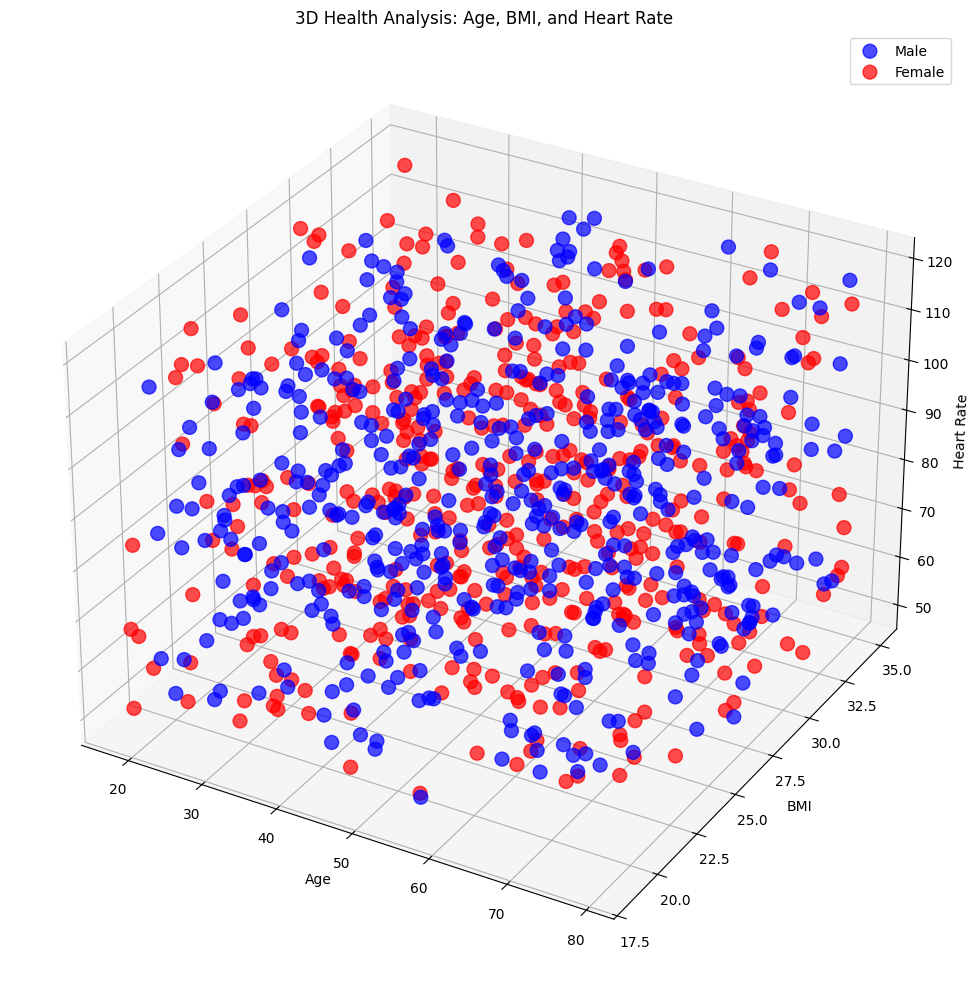

In [1]:
import pandas as pd
import matplotlib.pyplot as plt

file_path = "./health_lifestyle.csv"
df = pd.read_csv(file_path)

def plot_3d_health_analysis():
    fig = plt.figure(figsize=(12, 10))
    ax = fig.add_subplot(111, projection='3d')    
    df['Systolic'] = df['Blood_Pressure'].apply(lambda x: int(x.split('/')[0]))    
    colors = {'Male': 'blue', 'Female': 'red'}
    genders = df['Gender'].unique()    
    for gender in genders:
        subset = df[df['Gender'] == gender]
        ax.scatter(subset['Age'], subset['BMI'], subset['Heart_Rate'],
                   c=subset['Gender'].map(colors), label=gender, s=100, alpha=0.7)    
    ax.set_xlabel('Age')
    ax.set_ylabel('BMI')
    ax.set_zlabel('Heart Rate')
    ax.set_title('3D Health Analysis: Age, BMI, and Heart Rate')    
    ax.legend()    
    plt.tight_layout()
    plt.show()
    
plot_3d_health_analysis()

C:\Users\HP\AppData\Local\Temp\ipykernel_8152\4084693132.py:12: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped = df.groupby(['Gender', 'Smoker', 'BMI_Category']).size().reset_index(name='Count')


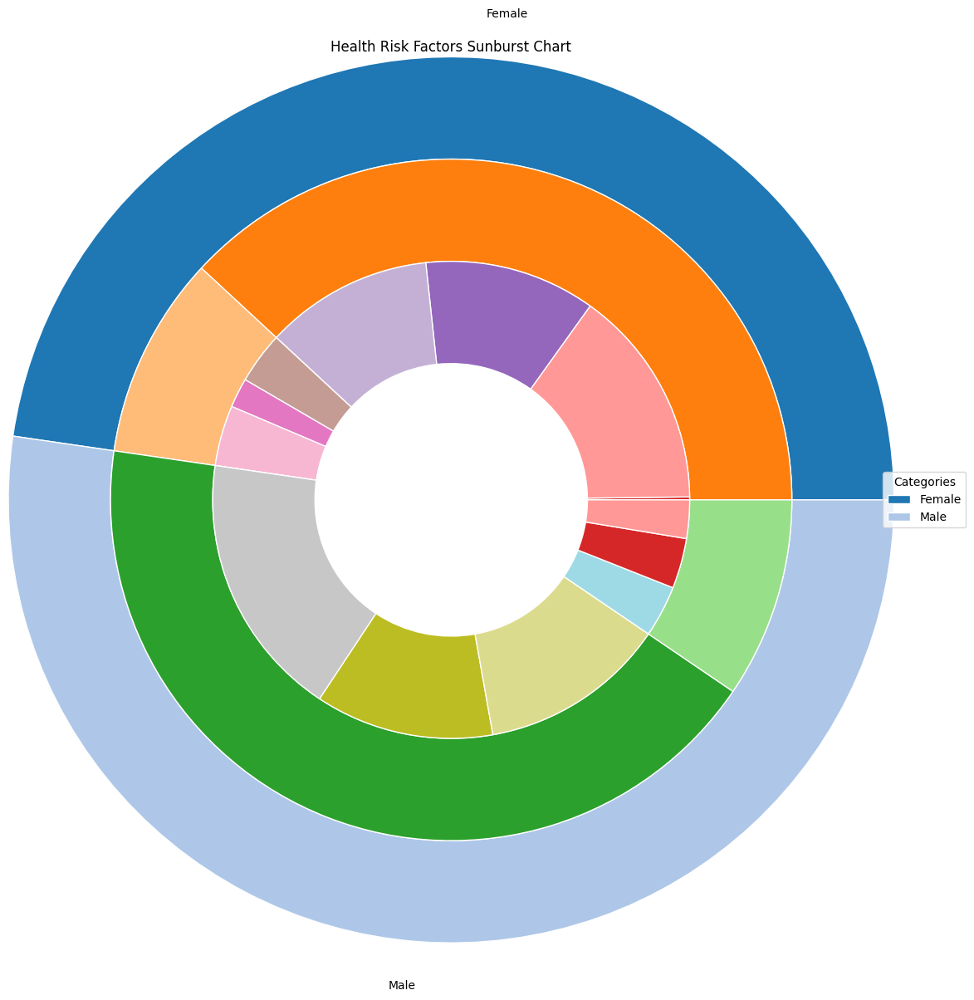

In [2]:
import pandas as pd
import matplotlib.pyplot as plt

file_path = "./health_lifestyle.csv"
df = pd.read_csv(file_path)

def plot_risk_factors_sunburst():
    df['BMI_Category'] = pd.cut(df['BMI'], 
                               bins=[0, 18.5, 25, 30, 100], 
                               labels=['Underweight', 'Normal', 'Overweight', 'Obese'])    
    fig = plt.figure(figsize=(12, 12))    
    grouped = df.groupby(['Gender', 'Smoker', 'BMI_Category']).size().reset_index(name='Count')    
    colors = plt.cm.tab20.colors    
    outer_vals = grouped.groupby('Gender')['Count'].sum()
    outer_labels = outer_vals.index    
    mid_vals = grouped.groupby(['Gender', 'Smoker'])['Count'].sum().values
    inner_vals = grouped['Count'].values
    ax = fig.add_subplot(111)    
    ax.pie(outer_vals, radius=1.3, labels=outer_labels, 
           colors=colors[:len(outer_vals)], 
           wedgeprops=dict(width=0.3, edgecolor='w'))    
    ax.pie(mid_vals, radius=1.0, labels=None,
           colors=colors[len(outer_vals):len(outer_vals)+len(mid_vals)], 
           wedgeprops=dict(width=0.3, edgecolor='w'))
    ax.pie(inner_vals, radius=0.7, labels=None,
           colors=colors[len(outer_vals)+len(mid_vals):], 
           wedgeprops=dict(width=0.3, edgecolor='w'))
    ax.set_title("Health Risk Factors Sunburst Chart", pad=20)
    plt.legend(title="Categories", loc="center left", bbox_to_anchor=(1, 0.5))
    plt.tight_layout()
    plt.show()
    
plot_risk_factors_sunburst()

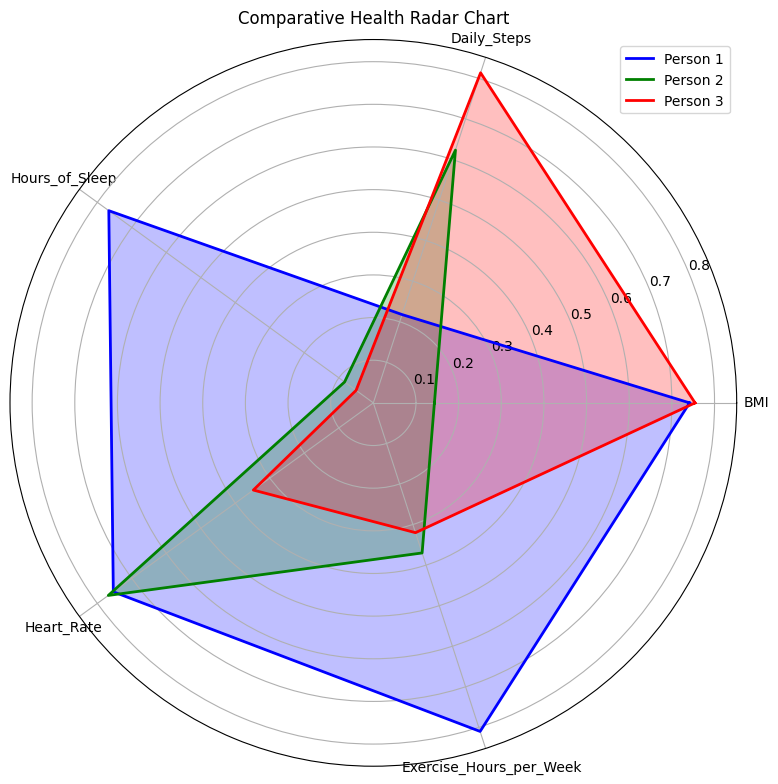

In [14]:
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np

file_path = "./health_lifestyle.csv"
df = pd.read_csv(file_path)

def plot_health_radar_chart():
    fig = plt.figure(figsize=(12, 8))    
    categories = ['BMI', 'Daily_Steps', 'Hours_of_Sleep', 'Heart_Rate', 'Exercise_Hours_per_Week']
    df_std = df.copy()
    for cat in categories:
        df_std[cat] = (df[cat] - df[cat].min()) / (df[cat].max() - df[cat].min())    
    num_people = min(3, len(df))    
    angles = np.linspace(0, 2*np.pi, len(categories), endpoint=False).tolist()
    angles += angles[:1]   
    ax = fig.add_subplot(111, polar=True)
    colors = ['blue', 'green', 'red']
    for i in range(num_people):
        values = df_std.loc[i, categories].values.flatten().tolist()
        values += values[:1]       
        ax.plot(angles, values, linewidth=2, color=colors[i], label=f"Person {df.loc[i, 'ID']}")
        ax.fill(angles, values, color=colors[i], alpha=0.25)
    ax.set_xticks(angles[:-1])
    ax.set_xticklabels(categories)
    ax.set_title("Comparative Health Radar Chart")
    plt.legend(loc='upper right')    
    plt.tight_layout()
    plt.show()
    
plot_health_radar_chart()

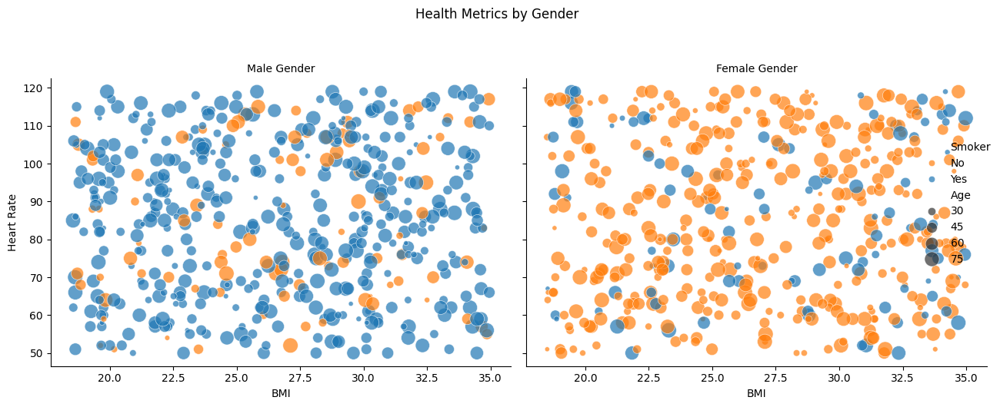

In [13]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

file_path = "./health_lifestyle.csv"
df = pd.read_csv(file_path)

def plot_facetgrid_metrics_by_gender():
    g = sns.FacetGrid(df, col="Gender", height=5, aspect=1.2)
    g.map_dataframe(sns.scatterplot, x="BMI", y="Heart_Rate", hue="Smoker", size="Age", sizes=(20, 200), alpha=0.7)
    g.add_legend()
    g.set_axis_labels("BMI", "Heart Rate")
    g.set_titles("{col_name} Gender")
    g.fig.suptitle("Health Metrics by Gender", y=1.05)
    plt.tight_layout()
    plt.show()
    
plot_facetgrid_metrics_by_gender()

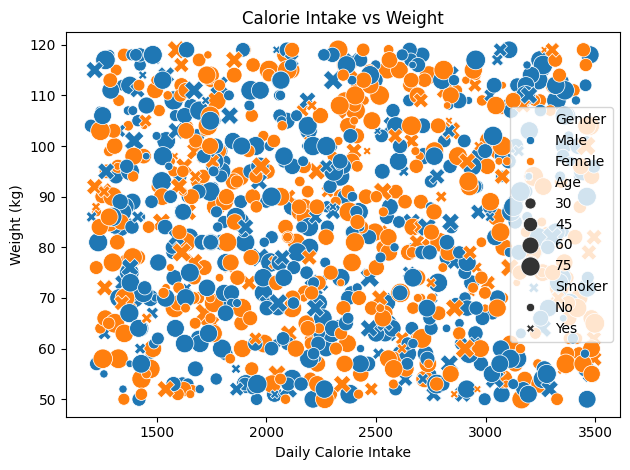

In [3]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

file_path = "./health_lifestyle.csv"
df = pd.read_csv(file_path)

def plot_calories_vs_weight():
    sns.scatterplot(x="Calories_Intake", y="Weight_kg", hue="Gender", style="Smoker", 
                   size="Age", sizes=(30, 200), data=df)
    plt.title("Calorie Intake vs Weight")
    plt.xlabel("Daily Calorie Intake")
    plt.ylabel("Weight (kg)")
    plt.tight_layout()
    plt.show()
    
plot_calories_vs_weight()

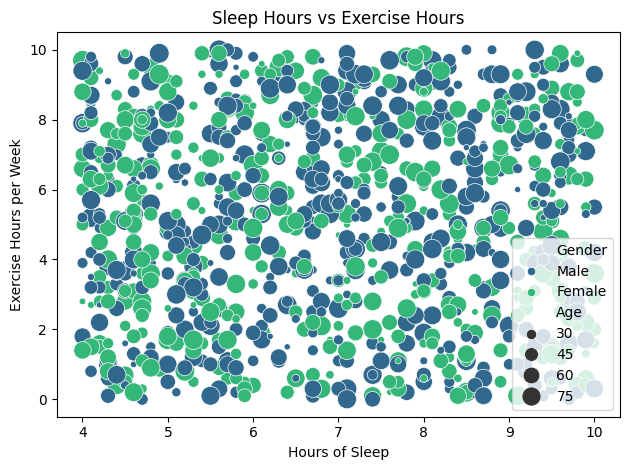

In [4]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

file_path = "./health_lifestyle.csv"
df = pd.read_csv(file_path)

def plot_sleep_vs_exercise():
    sns.scatterplot(x="Hours_of_Sleep", y="Exercise_Hours_per_Week", hue="Gender", size="Age", 
                    sizes=(20, 200), palette="viridis", data=df)
    plt.title("Sleep Hours vs Exercise Hours")
    plt.xlabel("Hours of Sleep")
    plt.ylabel("Exercise Hours per Week")
    plt.tight_layout()
    plt.show()
    
plot_sleep_vs_exercise()

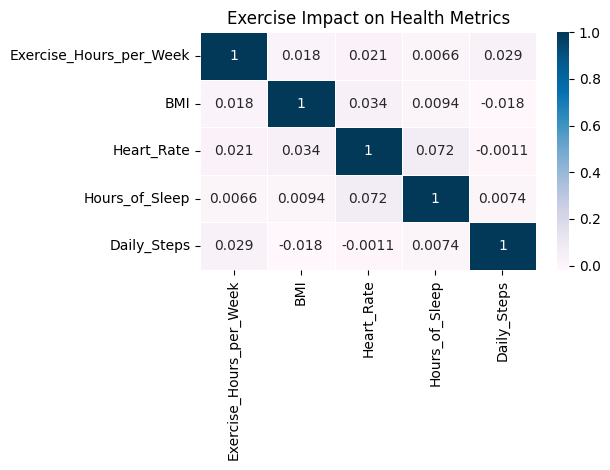

In [5]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

file_path = "./health_lifestyle.csv"
df = pd.read_csv(file_path)

def plot_exercise_impact_correlation():
    impact_vars = ['Exercise_Hours_per_Week', 'BMI', 'Heart_Rate', 'Hours_of_Sleep', 'Daily_Steps']
    impact_df = df[impact_vars]
    sns.heatmap(impact_df.corr(), annot=True, cmap="PuBu", linewidths=0.5)
    plt.title("Exercise Impact on Health Metrics")
    plt.tight_layout()
    plt.show()
    
plot_exercise_impact_correlation()

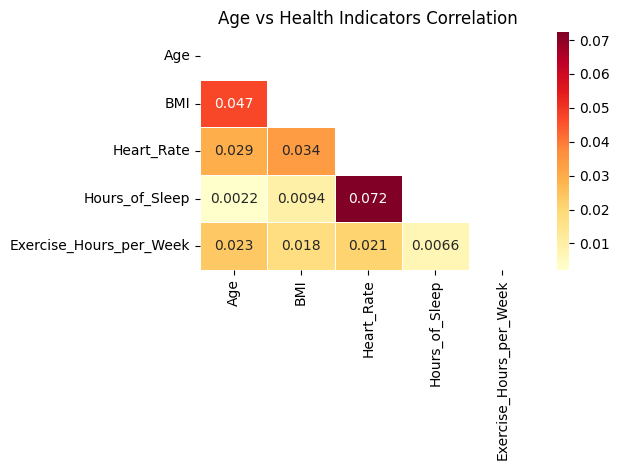

In [6]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np

file_path = "./health_lifestyle.csv"
df = pd.read_csv(file_path)

def plot_age_health_correlation():
    health_indicators = ['Age', 'BMI', 'Heart_Rate', 'Hours_of_Sleep', 'Exercise_Hours_per_Week']
    corr_matrix = df[health_indicators].corr()
    mask = np.zeros_like(corr_matrix)
    mask[np.triu_indices_from(mask)] = True
    sns.heatmap(corr_matrix, mask=mask, annot=True, cmap="YlOrRd", linewidths=0.5)
    plt.title("Age vs Health Indicators Correlation")
    plt.tight_layout()
    plt.show()
    
plot_age_health_correlation()

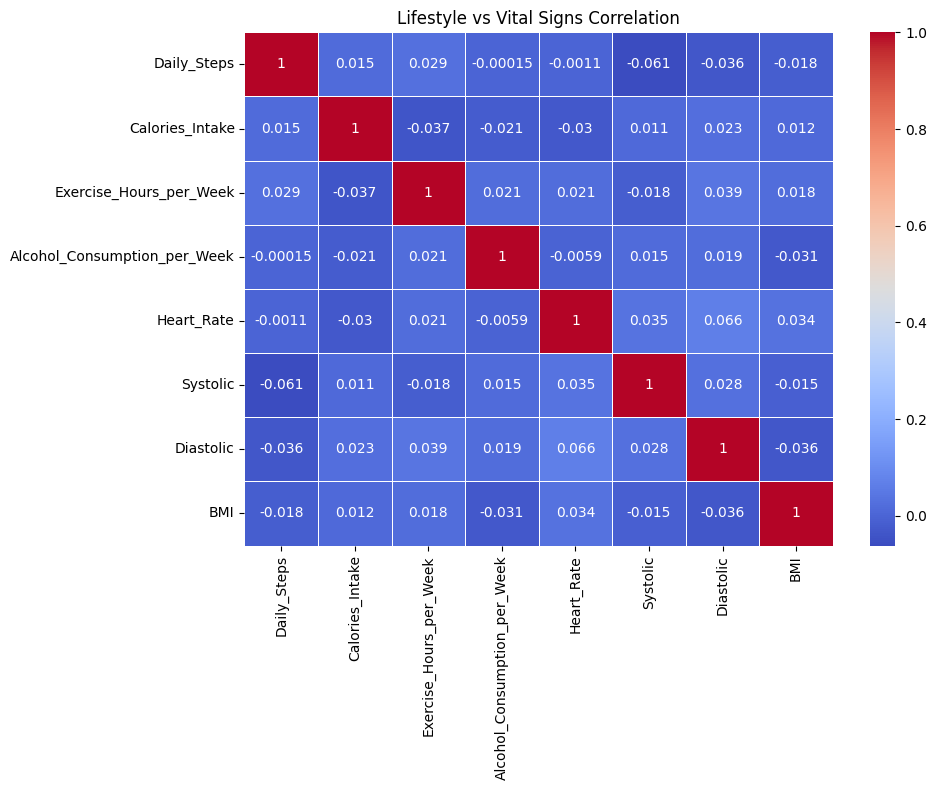

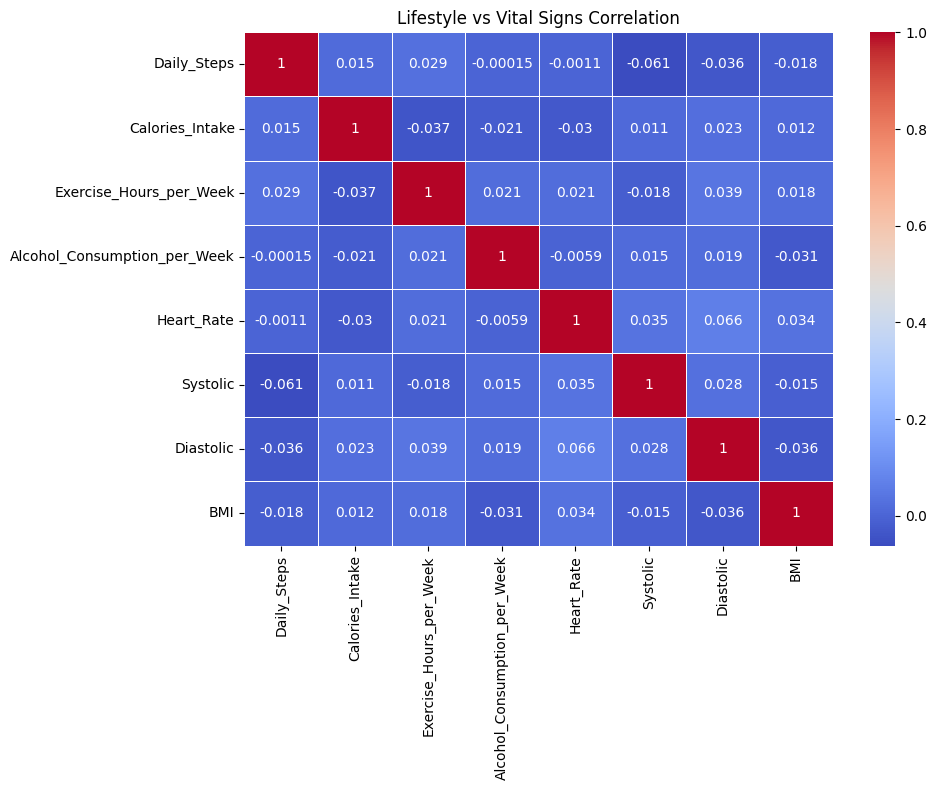

In [7]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

file_path = "./health_lifestyle.csv"
df = pd.read_csv(file_path)

def plot_lifestyle_vital_correlation():
    lifestyle = ['Daily_Steps', 'Calories_Intake', 'Exercise_Hours_per_Week', 'Alcohol_Consumption_per_Week']    
    df['Systolic'] = df['Blood_Pressure'].apply(lambda x: int(x.split('/')[0]))
    df['Diastolic'] = df['Blood_Pressure'].apply(lambda x: int(x.split('/')[1]))    
    vitals = ['Heart_Rate', 'Systolic', 'Diastolic', 'BMI']
    fig = plt.figure(figsize=(10,8))
    lifestyle_vital_df = df[lifestyle + vitals]
    sns.heatmap(lifestyle_vital_df.corr(), annot=True, cmap="coolwarm", linewidths=0.5)
    plt.title("Lifestyle vs Vital Signs Correlation")
    plt.tight_layout()
    return fig
    
plot_lifestyle_vital_correlation()

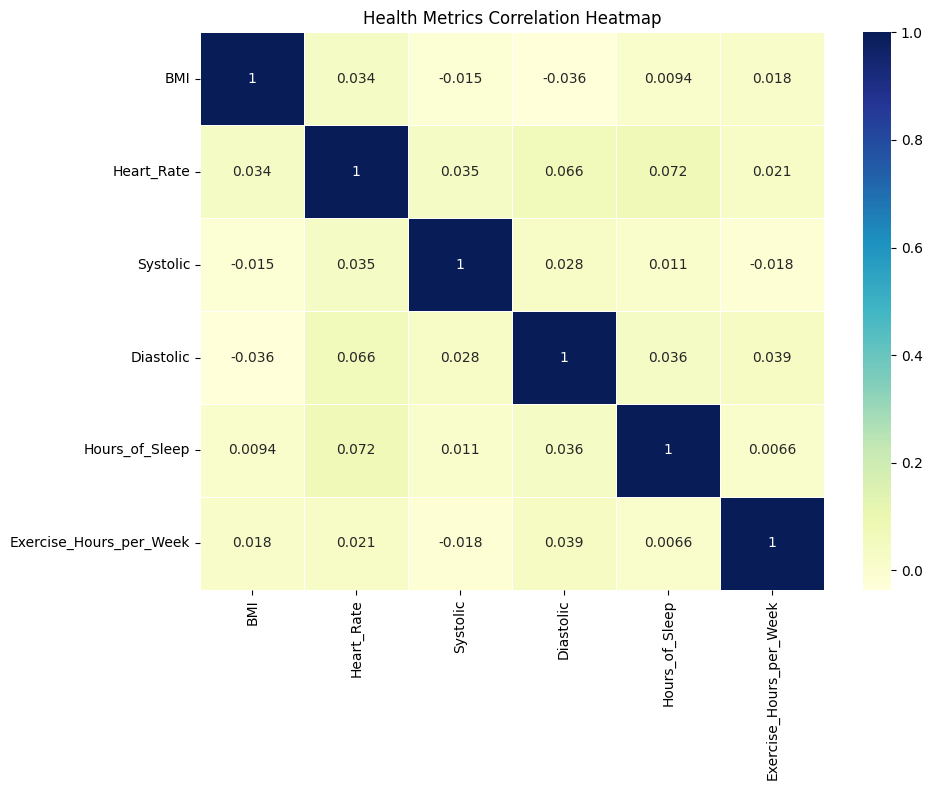

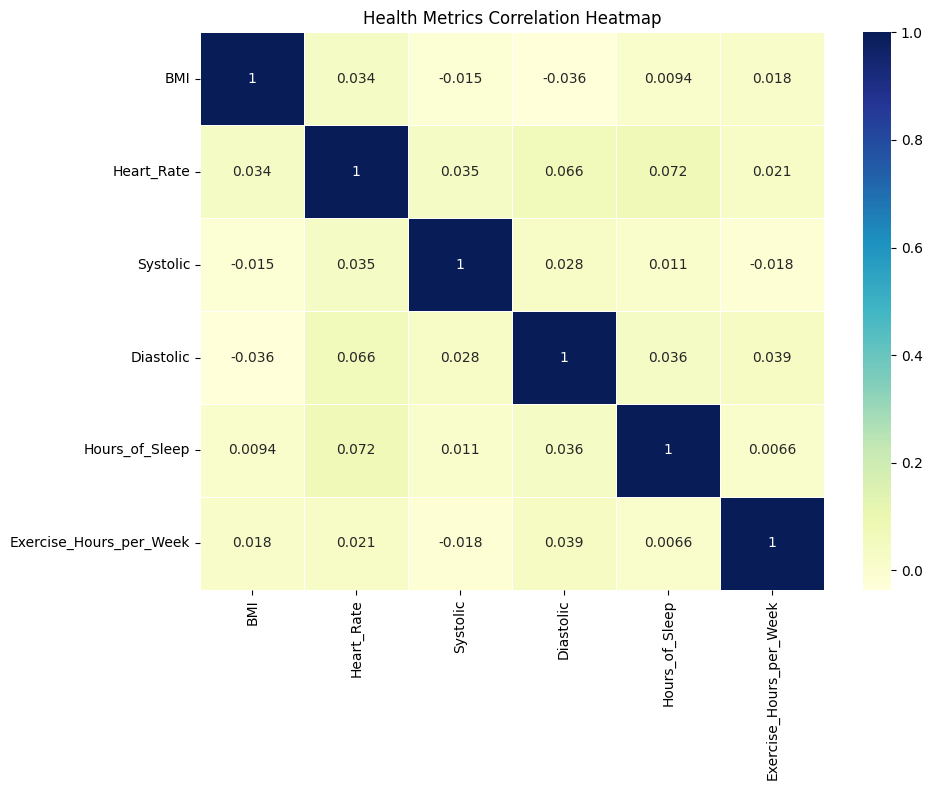

In [8]:
import pandas as pd
import matplotlib.pyplot as plt
import matplotlib.pyplot as plt
import seaborn as sns

file_path = "./health_lifestyle.csv"
df = pd.read_csv(file_path)

def plot_health_metrics_heatmap():
    health_metrics = ['BMI', 'Heart_Rate', 'Blood_Pressure', 'Hours_of_Sleep', 'Exercise_Hours_per_Week']    
    df['Systolic'] = df['Blood_Pressure'].apply(lambda x: int(x.split('/')[0]))
    df['Diastolic'] = df['Blood_Pressure'].apply(lambda x: int(x.split('/')[1]))
    metrics_df = df[['BMI', 'Heart_Rate', 'Systolic', 'Diastolic', 'Hours_of_Sleep', 'Exercise_Hours_per_Week']]
    fig = plt.figure(figsize=(10,8))
    sns.heatmap(metrics_df.corr(), annot=True, cmap="YlGnBu", linewidths=0.5)
    plt.title("Health Metrics Correlation Heatmap")
    plt.tight_layout()
    return fig
    
plot_health_metrics_heatmap()

C:\Users\HP\AppData\Local\Temp\ipykernel_8152\3719113700.py:10: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x="Diabetic", y="Heart_Rate", data=df, palette="RdYlBu")


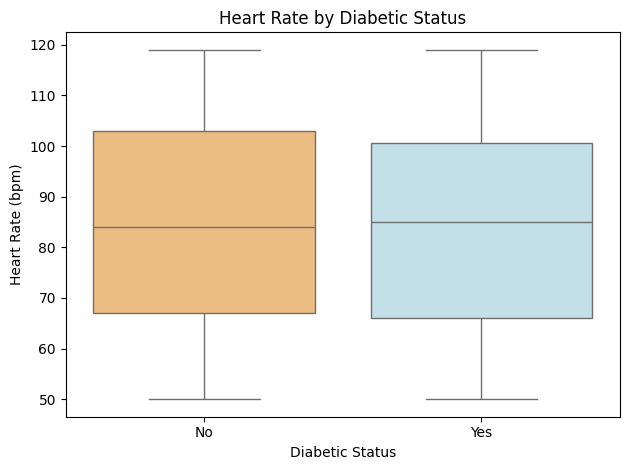

In [9]:
import pandas as pd
import matplotlib.pyplot as plt
import matplotlib.pyplot as plt
import seaborn as sns

file_path = "./health_lifestyle.csv"
df = pd.read_csv(file_path)

def plot_heart_rate_by_diabetic():
    sns.boxplot(x="Diabetic", y="Heart_Rate", data=df, palette="RdYlBu")
    plt.title("Heart Rate by Diabetic Status")
    plt.xlabel("Diabetic Status")
    plt.ylabel("Heart Rate (bpm)")
    plt.tight_layout()
    plt.show()
    
plot_heart_rate_by_diabetic()

C:\Users\HP\AppData\Local\Temp\ipykernel_8152\1355614768.py:11: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x="Age_Group", y="Hours_of_Sleep", data=df, palette="viridis")


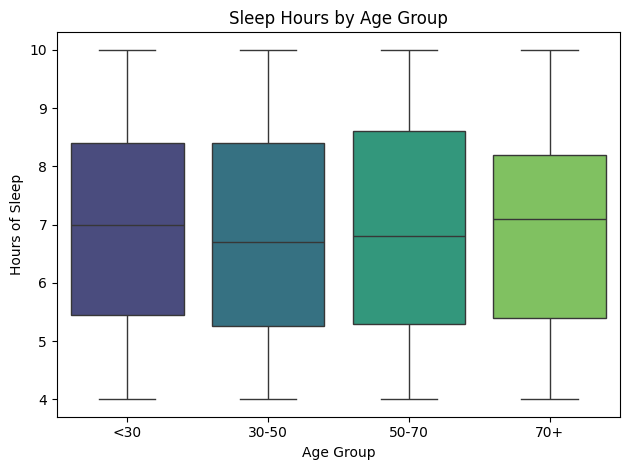

In [10]:
import pandas as pd
import matplotlib.pyplot as plt
import matplotlib.pyplot as plt
import seaborn as sns

file_path = "./health_lifestyle.csv"
df = pd.read_csv(file_path)

def plot_sleep_by_age_group():
    df['Age_Group'] = pd.cut(df['Age'], bins=[0, 30, 50, 70, 100], labels=['<30', '30-50', '50-70', '70+'])
    sns.boxplot(x="Age_Group", y="Hours_of_Sleep", data=df, palette="viridis")
    plt.title("Sleep Hours by Age Group")
    plt.xlabel("Age Group")
    plt.ylabel("Hours of Sleep")
    plt.tight_layout()
    plt.show()
    
plot_sleep_by_age_group()

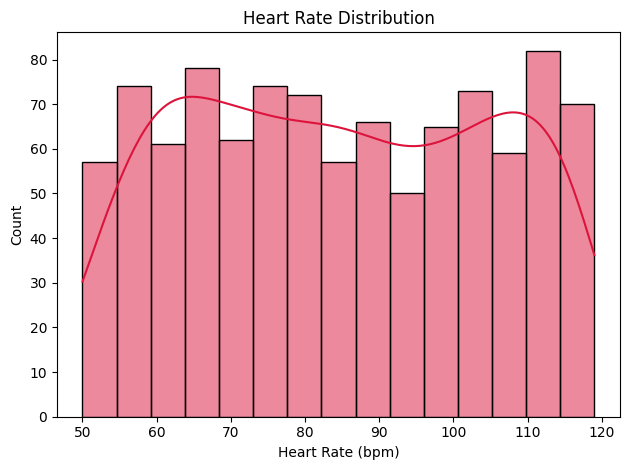

In [11]:
import pandas as pd
import matplotlib.pyplot as plt
import matplotlib.pyplot as plt
import seaborn as sns

file_path = "./health_lifestyle.csv"
df = pd.read_csv(file_path)

def plot_heart_rate_distribution():
    sns.histplot(df['Heart_Rate'], bins=15, kde=True, color="crimson")
    plt.title("Heart Rate Distribution")
    plt.xlabel("Heart Rate (bpm)")
    plt.ylabel("Count")
    plt.tight_layout()
    plt.show()
    
plot_heart_rate_distribution()

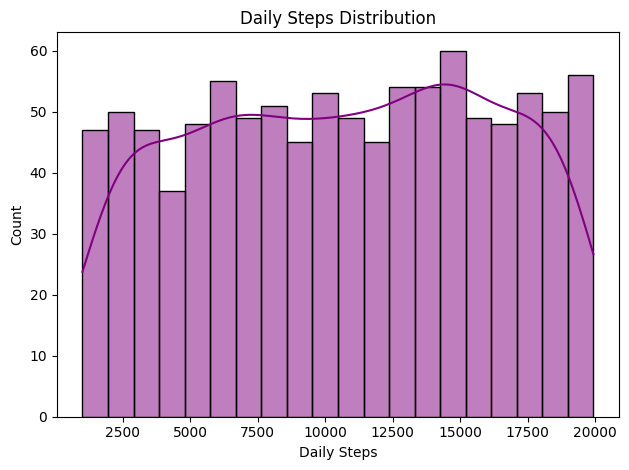

In [12]:
import pandas as pd
import matplotlib.pyplot as plt
import matplotlib.pyplot as plt
import seaborn as sns

file_path = "./health_lifestyle.csv"
df = pd.read_csv(file_path)

def plot_steps_distribution():
    sns.histplot(df['Daily_Steps'], bins=20, kde=True, color="purple")
    plt.title("Daily Steps Distribution")
    plt.xlabel("Daily Steps")
    plt.ylabel("Count")
    plt.tight_layout()
    plt.show()
    
plot_steps_distribution()

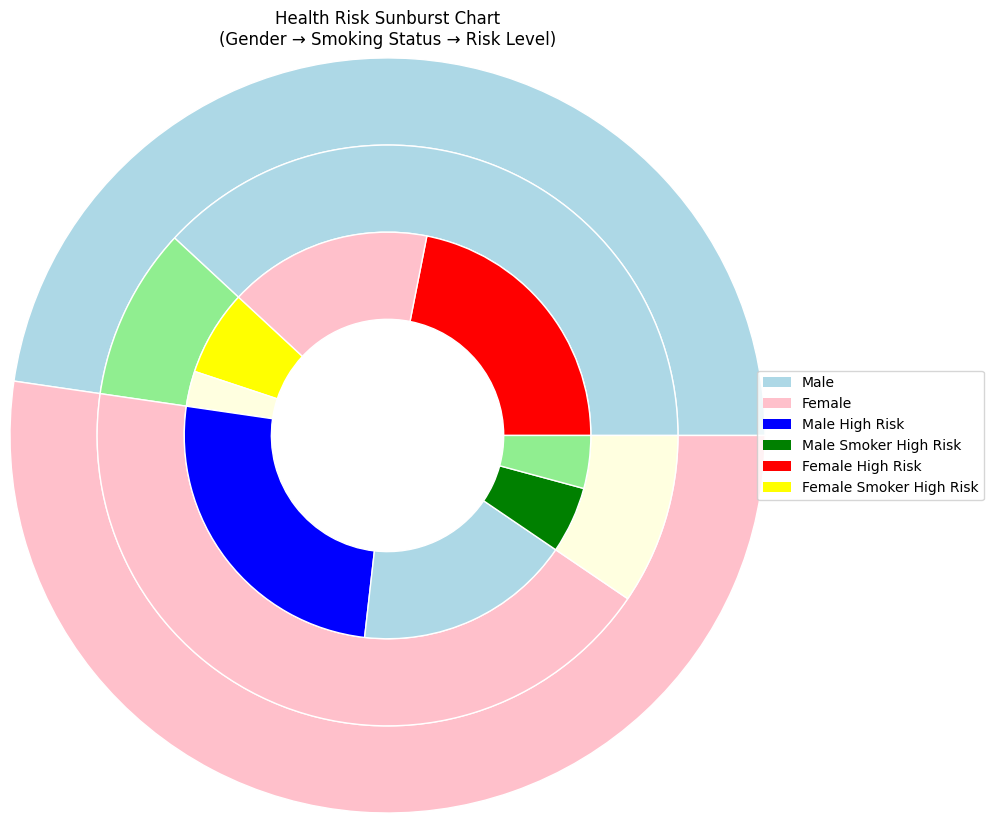

In [13]:
import pandas as pd
import matplotlib.pyplot as plt
import matplotlib.pyplot as plt
import numpy as np
import matplotlib.patches as mpatches

file_path = "./health_lifestyle.csv"
df = pd.read_csv(file_path)

def plot_sunburst():
    df['Health_Risk'] = np.where((df['BMI'] > 30) | (df['Heart_Rate'] > 90), 
                               'High', 'Low')
    grouped = df.groupby(['Gender', 'Smoker', 'Health_Risk']).size().reset_index(name='Count')
    fig, ax = plt.subplots(figsize=(10, 10), subplot_kw=dict(aspect="equal"))    
    colors = {
        ('Male', 'No', 'Low'): 'lightblue',
        ('Male', 'No', 'High'): 'blue',
        ('Male', 'Yes', 'Low'): 'lightgreen',
        ('Male', 'Yes', 'High'): 'green',
        ('Female', 'No', 'Low'): 'pink',
        ('Female', 'No', 'High'): 'red',
        ('Female', 'Yes', 'Low'): 'lightyellow',
        ('Female', 'Yes', 'High'): 'yellow'
    }    
    outer_vals = grouped.groupby('Gender')['Count'].sum()
    wedges_outer, _ = ax.pie(outer_vals, radius=1.3, 
                             colors=['lightblue', 'pink'], 
                             wedgeprops=dict(width=0.3, edgecolor='w'))
    mid_vals = grouped.groupby(['Gender', 'Smoker'])['Count'].sum()
    wedges_mid, _ = ax.pie(mid_vals, radius=1.0, 
                           colors=['lightblue', 'lightgreen', 'pink', 'lightyellow'], 
                           wedgeprops=dict(width=0.3, edgecolor='w'))
    inner_vals = grouped['Count']
    wedges_inner, _ = ax.pie(inner_vals, radius=0.7, 
                             colors=[colors[tuple(x)] for x in grouped[['Gender', 'Smoker', 'Health_Risk']].values], 
                             wedgeprops=dict(width=0.3, edgecolor='w'))    
    ax.set_title("Health Risk Sunburst Chart\n(Gender → Smoking Status → Risk Level)", pad=20)    
    legend_elements = [
        mpatches.Patch(facecolor='lightblue', label='Male'),
        mpatches.Patch(facecolor='pink', label='Female'),
        mpatches.Patch(facecolor='blue', label='Male High Risk'),
        mpatches.Patch(facecolor='green', label='Male Smoker High Risk'),
        mpatches.Patch(facecolor='red', label='Female High Risk'),
        mpatches.Patch(facecolor='yellow', label='Female Smoker High Risk')
    ]
    ax.legend(handles=legend_elements, bbox_to_anchor=(1, 0.5), loc='center left')
    plt.tight_layout()
    plt.show()
    
plot_sunburst()

C:\Users\HP\AppData\Local\Temp\ipykernel_5808\768702572.py:26: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


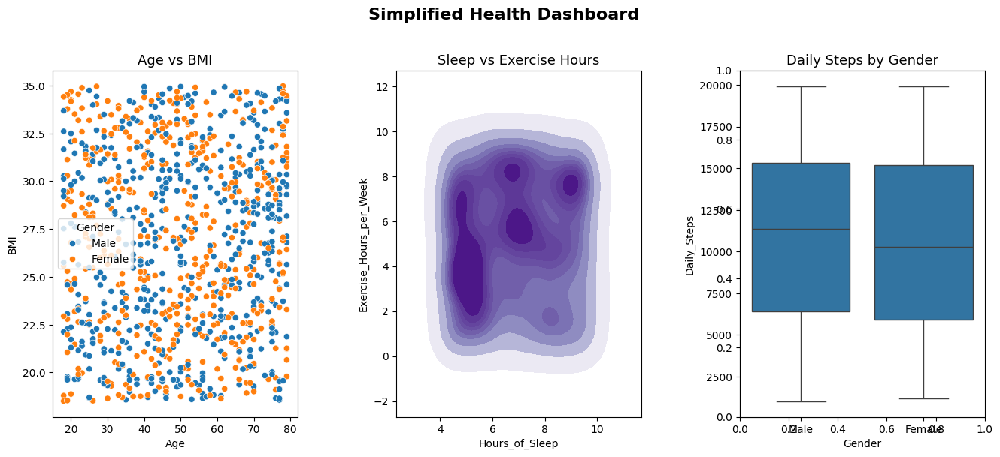

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
import matplotlib.pyplot as plt
import seaborn as sns
from matplotlib.gridspec import GridSpec
import seaborn as sns

file_path = "./health_lifestyle.csv"
df = pd.read_csv(file_path)

def plot_health_dashboard():
    fig = plt.figure(figsize=(16, 6))  
    gs = GridSpec(1, 3, figure=fig, wspace=0.4) 
    ax1 = fig.add_subplot(gs[0, 0])
    sns.scatterplot(x='Age', y='BMI', hue='Gender', data=df, ax=ax1)
    ax1.set_title('Age vs BMI', fontsize=13)
    ax2 = fig.add_subplot(gs[0, 1])
    sns.kdeplot(data=df, x='Hours_of_Sleep', y='Exercise_Hours_per_Week',
                cmap='Purples', fill=True, ax=ax2)
    ax2.set_title('Sleep vs Exercise Hours', fontsize=13)
    ax3 = fig.add_subplot(gs[0, 2])
    ax3 = fig.add_subplot(gs[0, 2])
    sns.boxplot(x='Gender', y='Daily_Steps', data=df, ax=ax3)
    ax3.set_title('Daily Steps by Gender', fontsize=13)
    plt.tight_layout()
    fig.suptitle('Simplified Health Dashboard', fontsize=16, weight='bold', y=1.02)
    plt.show()
    
plot_health_dashboard()

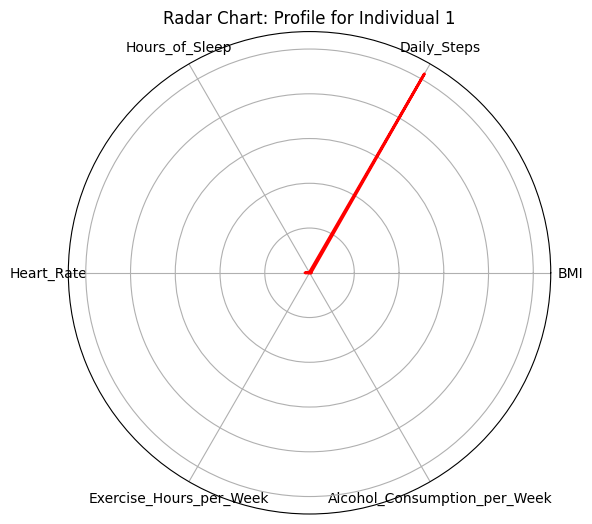

In [14]:
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np

file_path = "./health_lifestyle.csv"
df = pd.read_csv(file_path)

def plot_radar_chart(index=0):
    fig = plt.figure(figsize=(6, 6))
    categories = ['BMI', 'Daily_Steps', 'Hours_of_Sleep', 'Heart_Rate', 'Exercise_Hours_per_Week', 'Alcohol_Consumption_per_Week']
    values = df.loc[index, categories].values.flatten().tolist()
    values += values[:1]  
    angles = np.linspace(0, 2 * np.pi, len(categories), endpoint=False).tolist()
    angles += angles[:1]
    ax = fig.add_subplot(111, polar=True)
    ax.plot(angles, values, color='r', linewidth=2)
    ax.fill(angles, values, color='r', alpha=0.25)
    ax.set_yticklabels([])
    ax.set_xticks(angles[:-1])
    ax.set_xticklabels(categories)
    ax.set_title(f"Radar Chart: Profile for Individual {df.loc[index, 'ID']}")
    plt.tight_layout()
    plt.show()
    
plot_radar_chart()

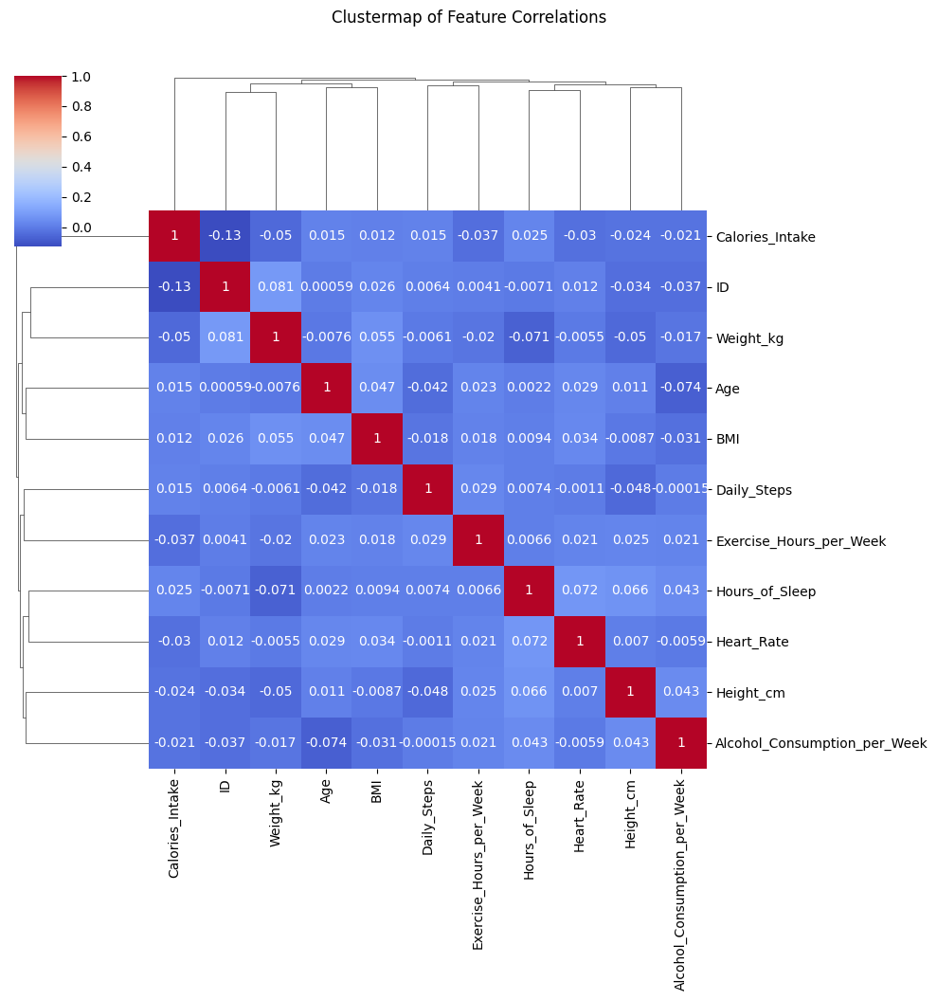

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

file_path = "./health_lifestyle.csv"
df = pd.read_csv(file_path)

def plot_clustermap():
    numeric_df = df.select_dtypes(include=["float64", "int64"])
    g = sns.clustermap(numeric_df.corr(), cmap="coolwarm", annot=True)
    g.fig.suptitle("Clustermap of Feature Correlations", y=1.05)
    plt.show()
    
plot_clustermap()

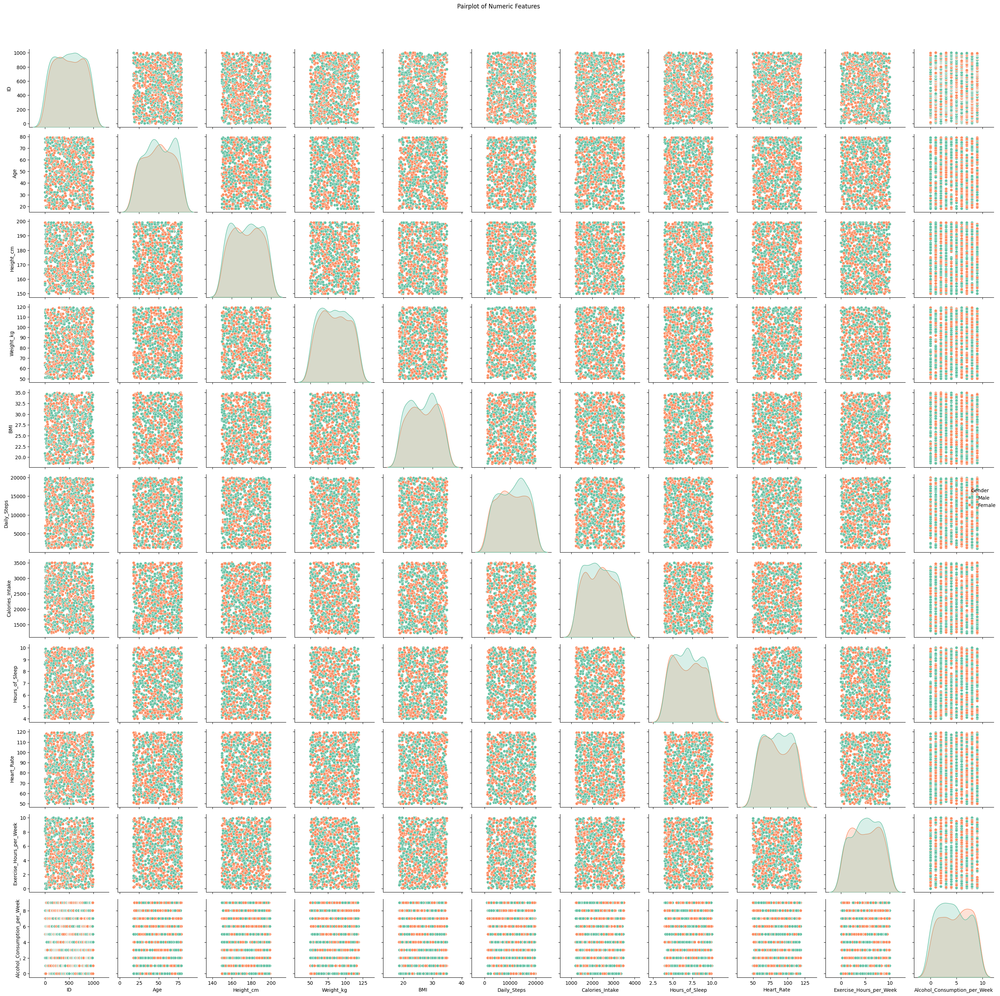

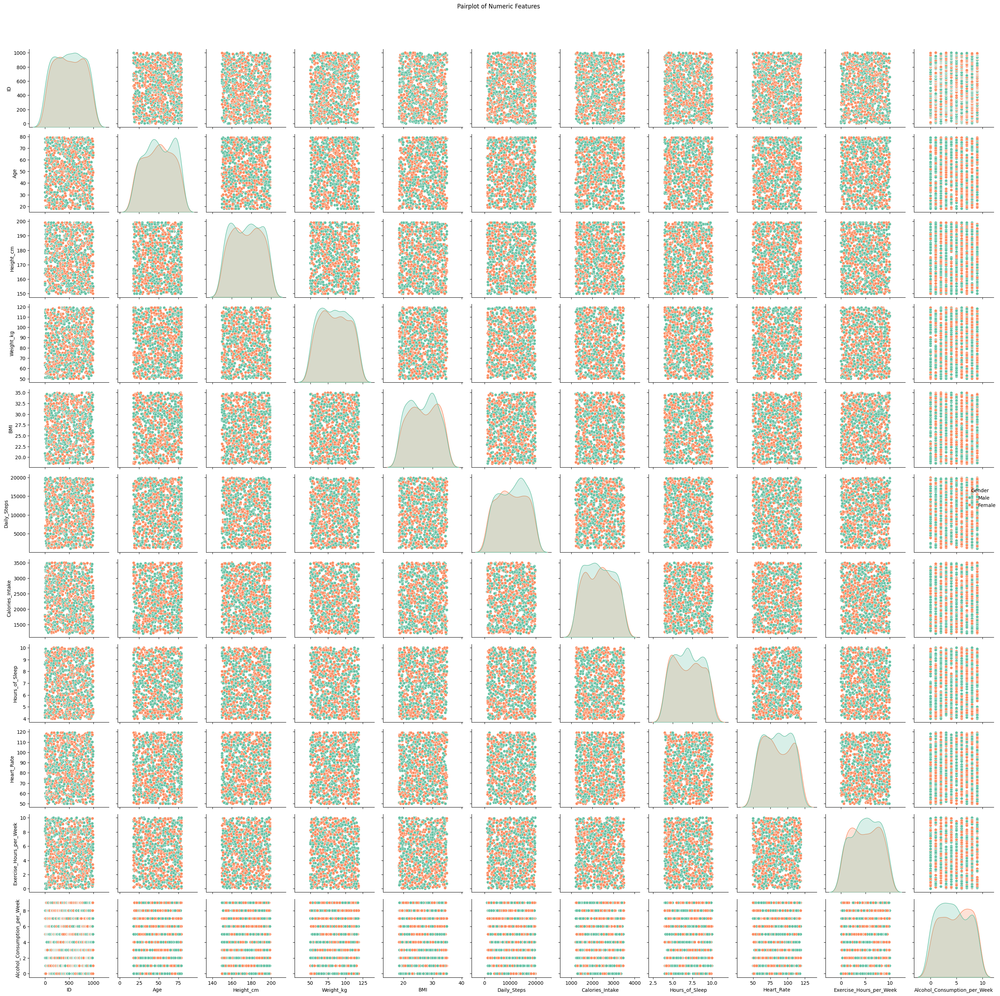

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

file_path = "./health_lifestyle.csv"
df = pd.read_csv(file_path)

def plot_pairplot():
    g = sns.pairplot(df, hue="Gender", palette="Set2", diag_kind="kde")
    g.figure.suptitle("Pairplot of Numeric Features", y=1.03)
    g.figure.tight_layout()  
    return g.figure
    
plot_pairplot()

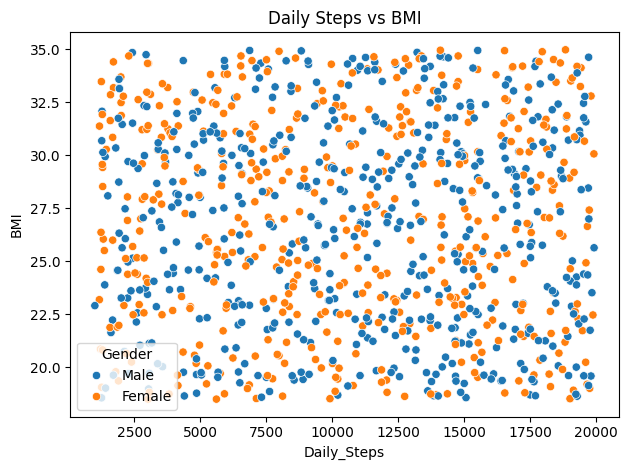

In [15]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np

file_path = "./health_lifestyle.csv"
df = pd.read_csv(file_path)

def plot_steps_vs_bmi():
    sns.scatterplot(x="Daily_Steps", y="BMI", data=df, hue="Gender")
    plt.title("Daily Steps vs BMI")
    plt.tight_layout()
    plt.show()
    
plot_steps_vs_bmi()

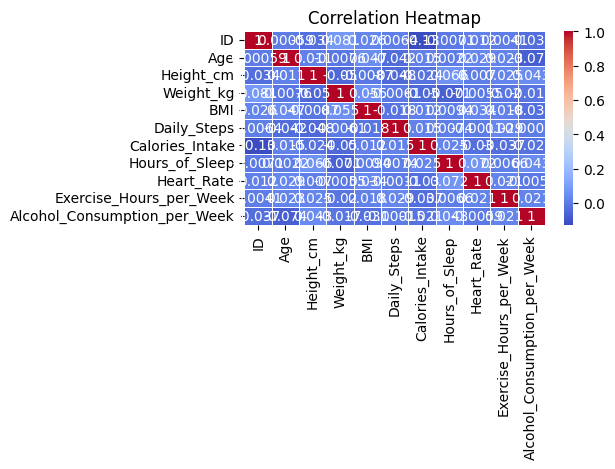

In [16]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np

file_path = "./health_lifestyle.csv"
df = pd.read_csv(file_path)

def plot_heatmap():
    sns.heatmap(df.corr(numeric_only=True), annot=True, cmap="coolwarm", linewidths=0.5)
    plt.title("Correlation Heatmap")
    plt.tight_layout()
    plt.show()
    
plot_heatmap()

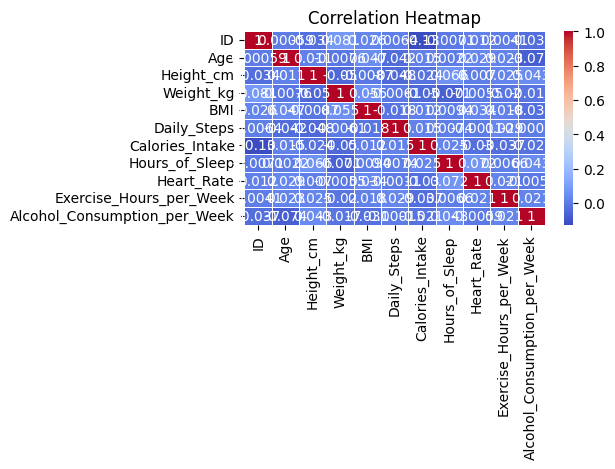

In [19]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np

file_path = "./health_lifestyle.csv"
df = pd.read_csv(file_path)

def plot_heatmap():
    sns.heatmap(df.corr(numeric_only=True), annot=True, cmap="coolwarm", linewidths=0.5)
    plt.title("Correlation Heatmap")
    plt.tight_layout()
    plt.show()
    
plot_heatmap()

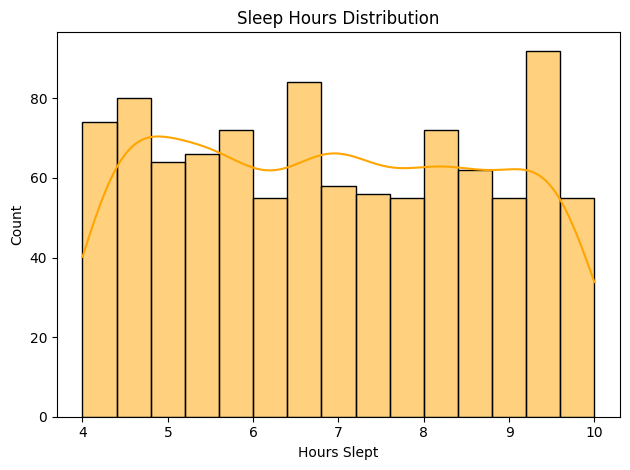

In [20]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np

file_path = "./health_lifestyle.csv"
df = pd.read_csv(file_path)

def plot_sleep_distribution():
    sns.histplot(df['Hours_of_Sleep'], bins=15, kde=True, color="orange")
    plt.title("Sleep Hours Distribution")
    plt.xlabel("Hours Slept")
    plt.ylabel("Count")
    plt.tight_layout()
    plt.show()
    
plot_sleep_distribution()

C:\Users\HP\AppData\Local\Temp\ipykernel_8152\3197646499.py:10: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x="Smoker", y="Exercise_Hours_per_Week", data=df, palette="Set3")


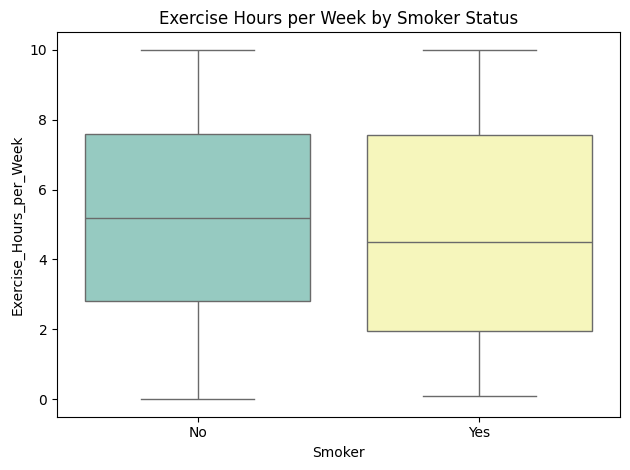

In [21]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np

file_path = "./health_lifestyle.csv"
df = pd.read_csv(file_path)

def plot_exercise_by_smoker():
    sns.boxplot(x="Smoker", y="Exercise_Hours_per_Week", data=df, palette="Set3")
    plt.title("Exercise Hours per Week by Smoker Status")
    plt.tight_layout()
    plt.show()
    
plot_exercise_by_smoker()

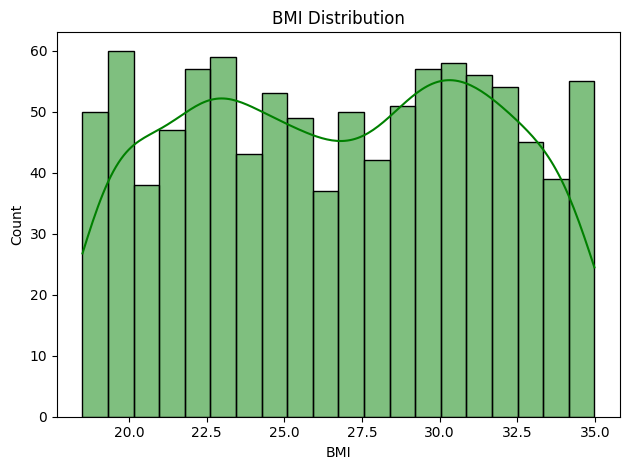

In [22]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np

file_path = "./health_lifestyle.csv"
df = pd.read_csv(file_path)

def plot_bmi_distribution():
    sns.histplot(df['BMI'], bins=20, kde=True, color="green")
    plt.title("BMI Distribution")
    plt.xlabel("BMI")
    plt.ylabel("Count")
    plt.tight_layout()
    plt.show()
    
plot_bmi_distribution()

C:\Users\HP\AppData\Local\Temp\ipykernel_8152\1023227633.py:11: FutureWarning: 

Setting a gradient palette using color= is deprecated and will be removed in v0.14.0. Set `palette='dark:.2'` for the same effect.

  sns.swarmplot(x="Smoker", y="BMI", hue="Gender", data=df, dodge=True, alpha=0.5, color=".2")


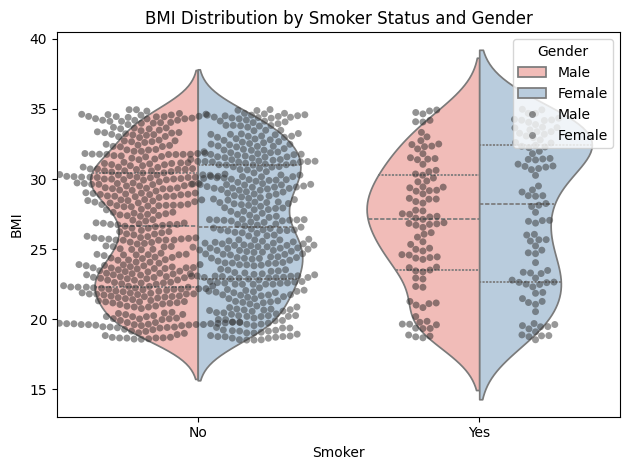

In [23]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np

file_path = "./health_lifestyle.csv"
df = pd.read_csv(file_path)

def plot_bmi_vs_smoker_by_gender():
    sns.violinplot(x="Smoker", y="BMI", hue="Gender", data=df, split=True, inner="quartile", palette="Pastel1")
    sns.swarmplot(x="Smoker", y="BMI", hue="Gender", data=df, dodge=True, alpha=0.5, color=".2")
    plt.title("BMI Distribution by Smoker Status and Gender")
    plt.xlabel("Smoker")
    plt.ylabel("BMI")
    plt.legend(title="Gender", loc='upper right')
    plt.tight_layout()
    plt.show()
    
plot_bmi_vs_smoker_by_gender()

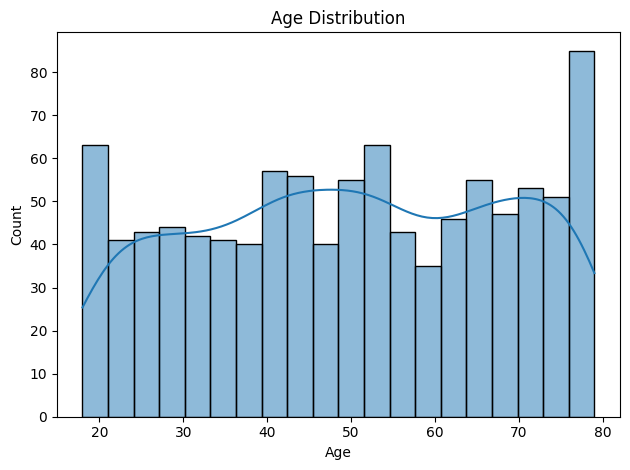

In [24]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

file_path = "./health_lifestyle.csv"
df = pd.read_csv(file_path)

def plot_age_distribution():
    sns.histplot(df['Age'], bins=20, kde=True)
    plt.title("Age Distribution")
    plt.xlabel("Age")
    plt.ylabel("Count")
    plt.tight_layout()
    plt.show()
    
plot_age_distribution()

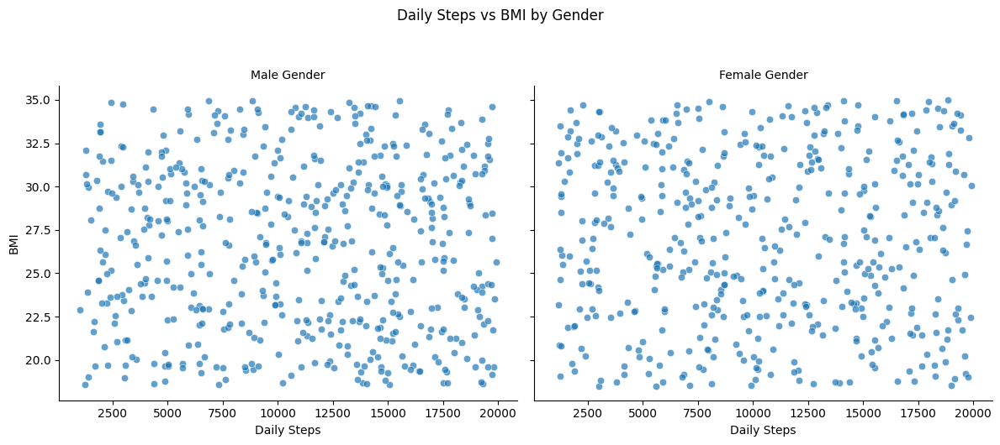

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

file_path = "./health_lifestyle.csv"
df = pd.read_csv(file_path)

def plot_facetgrid_steps_vs_bmi():
    g = sns.FacetGrid(df, col="Gender", height=5, aspect=1.2)
    g.map(sns.scatterplot, "Daily_Steps", "BMI", alpha=0.7)
    g.set_axis_labels("Daily Steps", "BMI")
    g.set_titles("{col_name} Gender")
    g.fig.suptitle("Daily Steps vs BMI by Gender", y=1.05)
    plt.tight_layout()
    plt.show()
    
plot_facetgrid_steps_vs_bmi()

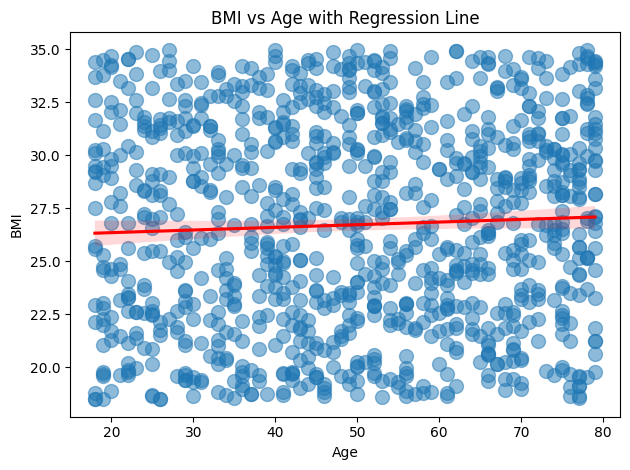

In [25]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

file_path = "./health_lifestyle.csv"
df = pd.read_csv(file_path)

def plot_bmi_vs_age():
    sns.regplot(x="Age", y="BMI", data=df, scatter_kws={'s': 100, 'alpha': 0.5}, line_kws={'color': 'red'})
    plt.title("BMI vs Age with Regression Line")
    plt.xlabel("Age")
    plt.ylabel("BMI")
    plt.tight_layout()
    plt.show()

plot_bmi_vs_age()

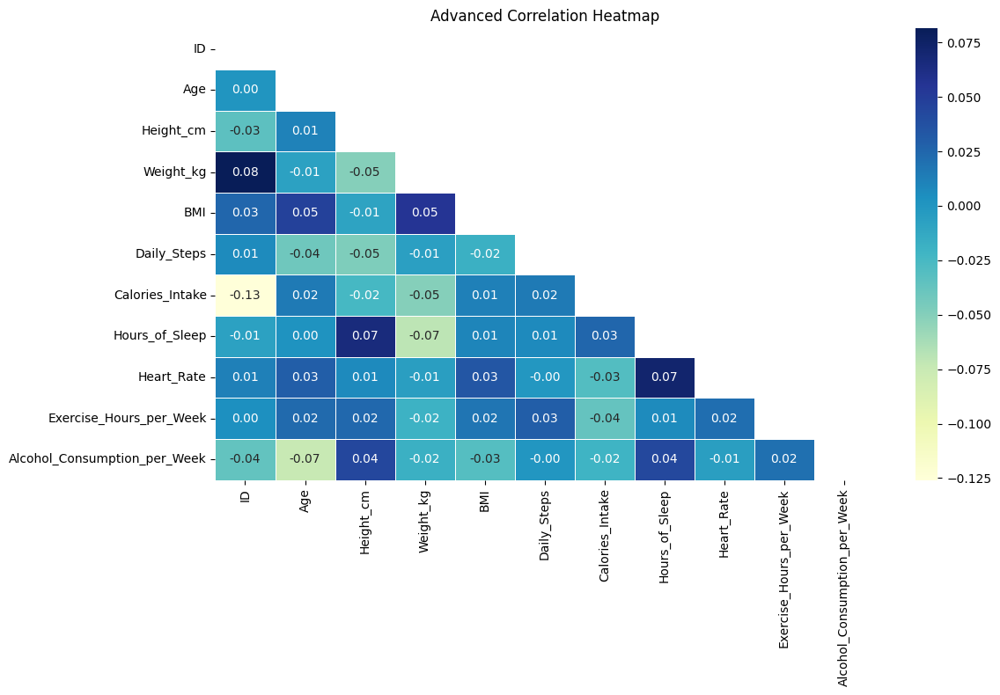

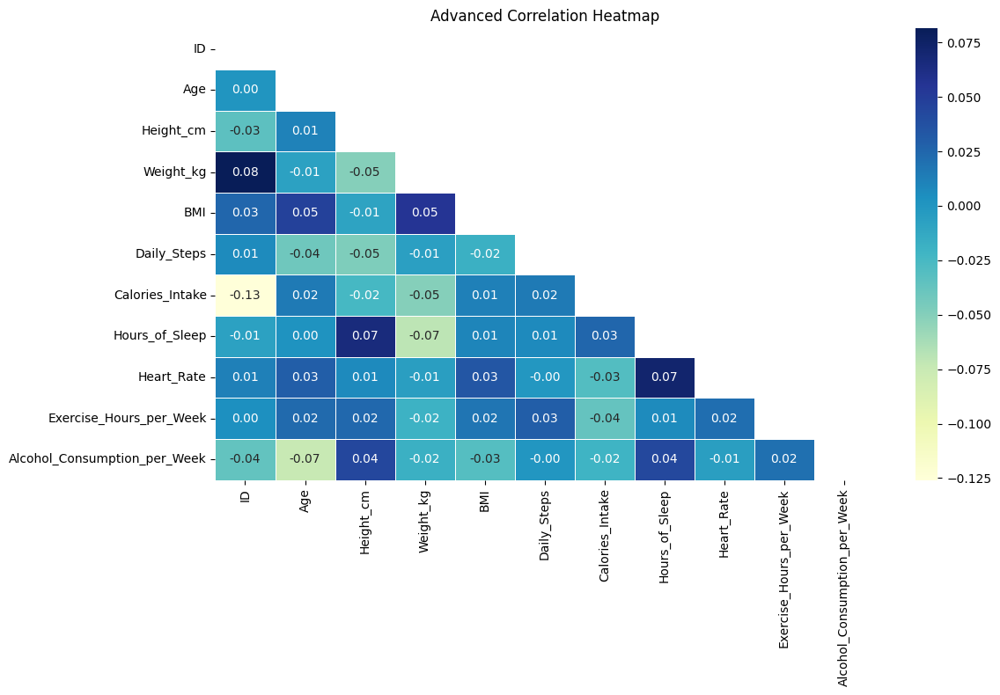

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np

file_path = "./health_lifestyle.csv"
df = pd.read_csv(file_path)

def plot_advanced_correlation_heatmap():
    corr = df.corr(numeric_only=True)
    mask = np.triu(np.ones_like(corr, dtype=bool))
    sns.heatmap(corr, mask=mask, annot=True, fmt=".2f", cmap="YlGnBu", linewidths=.5)
    plt.title("Advanced Correlation Heatmap")
    plt.tight_layout()
    plt.show()

plot_advanced_correlation_heatmap()

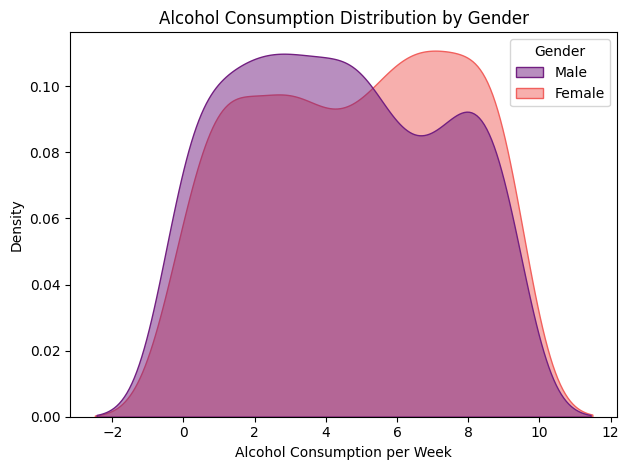

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

file_path = "./health_lifestyle.csv"
df = pd.read_csv(file_path)

def plot_alcohol_kde_by_gender():
    sns.kdeplot(data=df, x="Alcohol_Consumption_per_Week", hue="Gender", fill=True, common_norm=False, alpha=0.5, palette="magma")
    plt.title("Alcohol Consumption Distribution by Gender")
    plt.xlabel("Alcohol Consumption per Week")
    plt.ylabel("Density")
    plt.tight_layout()
    plt.show()

plot_alcohol_kde_by_gender()

C:\Users\HP\AppData\Local\Temp\ipykernel_5808\2159988224.py:11: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x="Alcohol_Consumption_per_Week", y="Heart_Rate", data=df, palette="Blues_d")


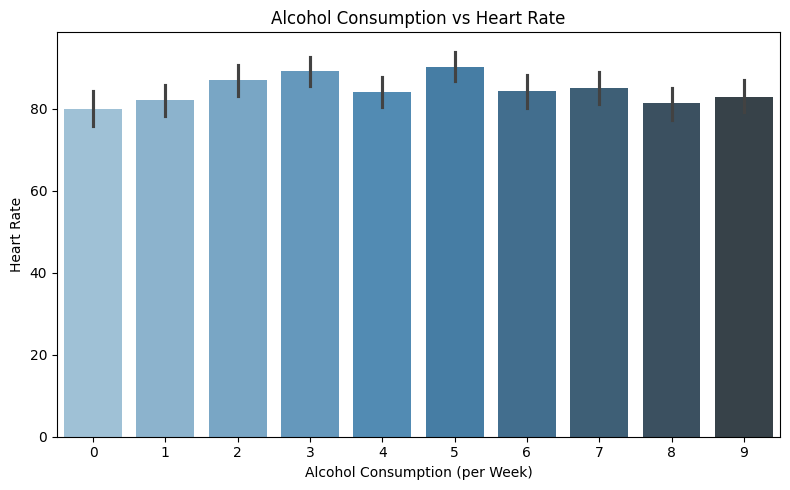

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

file_path = "./health_lifestyle.csv"
df = pd.read_csv(file_path)

def plot_alcohol_vs_heart_rate():
    sns.barplot(x="Alcohol_Consumption_per_Week", y="Heart_Rate", data=df, palette="Blues_d")
    plt.title("Alcohol Consumption vs Heart Rate")
    plt.xlabel("Alcohol Consumption (per Week)")
    plt.ylabel("Heart Rate")
    plt.tight_layout()
    plt.show()

plot_alcohol_vs_heart_rate()